In [2]:
from PIL import Image

import numpy as np
import pandas as pd
import os
from io import BytesIO
import matplotlib.pyplot as plt
import cv2

from keras.models import Model
from keras.models import load_model
from keras import backend as K

import tensorflow as tf

from keras.preprocessing.image import img_to_array, array_to_img
from sklearn.metrics import confusion_matrix, f1_score, precision_score, recall_score, roc_auc_score

In [3]:
sess = tf.Session(config=tf.ConfigProto(log_device_placement=True))
K.tensorflow_backend._get_available_gpus()

['/job:localhost/replica:0/task:0/device:GPU:0']

In [4]:
os.chdir('..')

In [5]:
os.getcwd()

'C:\\Users\\Leonardo\\forestfire'

In [6]:
val_dir = r'C:\Users\Leonardo\forestfire\images5\val'

In [7]:
test_dir = r'C:\Users\Leonardo\forestfire\images5\test'

In [8]:
def light_dark_selector(directory, dark_threshold, light_threshold):
    # Selects a list of images based on desired maximum light_threshold and minimum dark_threshold
    count = 0
    list_of_selected =[]
    min_intensity = 0
    file_min_intensity = ""
    max_intensity = 0
    file_max_intensity = ""

    for i in sorted(os.listdir(directory)):
        if 'original' in str(i):
            number = i.split('.')[0].split('_')[0]
            correspondent_mask = "%s_mask.png" %number
            img = Image.open(os.path.join(directory,i))
            mean_intensity = img_to_array(img).mean()
            
            if ((mean_intensity > dark_threshold) and (mean_intensity < light_threshold)):
                list_of_selected.append(i)
                list_of_selected.append(correspondent_mask)
                
                if mean_intensity >= max_intensity:
                    max_intensity = mean_intensity
                    file_max_intensity = i
                else:
                    min_intensity = mean_intensity
                    file_min_intensity = i
            else:
                pass
            
        if count % 1000 == 0:
            print(count)
        
        count += 1    
        
    print('minimal intensity was reached by %s file with %s of intensity' %(file_min_intensity, min_intensity))
    print('maximal intensity was reached by %s file with %s of intensity' %(file_max_intensity, max_intensity))
    
    return list_of_selected

In [9]:
def patch_maker(full_image, patch_size=384):
    #Function receives a 1920 * 1080 image and creates the patches of 384 x 384 as a list
    patches = []
    size_0 = 1920
    size_1 = 1152
    x_pos = 0
    y_pos = 0
    img2 = full_image
    #Applies a 8 pixels border on top to have exactly 510 patches of size 64 x 64 on the 1920 x 1088 images
    temp = Image.new('RGB', (1920, (1080 + 72)), color=0)
    temp.paste(img2, (0, 36))
    
    for i in range(int(size_0 / patch_size) * int(size_1 / patch_size)):
        if x_pos == size_0:
            x_pos = 0
            y_pos += patch_size

        patches.append(temp.crop(box=(x_pos, y_pos, x_pos + patch_size, y_pos + patch_size)).copy())

        x_pos += patch_size
            
    return patches

In [10]:
def patch_unmaker(patches, patch_size=384):
    #Function receives a list of patches of size 384 x 384 and creates an 1920 x 1080 image again
    size_0 = 1920
    size_1 = 1152
    img = Image.new('RGB', (size_0, size_1), color=0)
    x_pos = 0
    y_pos = 0
    
    for i in range(len(patches)):
        if x_pos == size_0:
            x_pos = 0
            y_pos += patch_size
            img.paste(patches[i], (x_pos, y_pos))
            x_pos += patch_size
        else:
            img.paste(patches[i], (x_pos, y_pos))
            x_pos += patch_size

    
    img = img.crop(box=(0,36, size_0, (size_1 - 36)))
    
    return img

In [11]:
#Loading the previous trained model
model = load_model('C:\\Users\\Leonardo\\forestfire\\segmenation_models\\unet_v5.h5py')

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use tf.cast instead.


In [19]:
def output_mask(input_dir, file, threshold=0.10):
    # Takes one specific image and predicts the correspondent mask considering the defined threshold
    
    number = file.split('.')[0].split('_')[0]
    thresholded_mask_name = "%s_thresholded_msk.png" %number

    img_read = Image.open(os.path.join(input_dir, file))
    patches = patch_maker(img_read)
    pred_patches = []
        
    for j in range(len(patches)):
        patch = img_to_array(patches[j]) / 255
        patch = patch.reshape((1,) + patch.shape)
        y_patches_pred = model.predict(patch)
        y_patches_pred[y_patches_pred>0.5] = 1
        y_patches_pred[y_patches_pred<=0.5] = 0

        y_patches_pred = y_patches_pred.reshape(384, 384, 1)
        
        if np.sum(y_patches_pred) > (threshold * 384 * 384):
            pred_patches.append(y_patches_pred)
        else:
            y_patches_pred = np.zeros((384, 384, 1))
            pred_patches.append(y_patches_pred)
            
    y_patches_pred_all = list(map(lambda img: array_to_img(img, scale=255), pred_patches))

    pred_mask = patch_unmaker(y_patches_pred_all)
    pred_mask.save(os.path.join(input_dir, thresholded_mask_name))

In [14]:
#Selecting just the day images from testset
sel_test_images = light_dark_selector(test_dir, 90,160)

0
1000
2000
3000
minimal intensity was reached by 9_original.png file with 126.49964 of intensity
maximal intensity was reached by 443_original.png file with 158.25064 of intensity


In [21]:
# Generating the masks with the model
for i in sorted(sel_test_images):
    if 'original' in str(i):
 
        print('Reading: ', i)
        number = i.split('.')[0].split('_')[0]
        predicted_mask_name = "%s_mask_predicted.png" %number
        output_mask(test_dir, i, threshold=0.10)
        print('Saving: ', predicted_mask_name)

Reading:  0_original.png
Saving:  0_mask_predicted.png
Reading:  1000_original.png
Saving:  1000_mask_predicted.png
Reading:  1001_original.png
Saving:  1001_mask_predicted.png
Reading:  1002_original.png
Saving:  1002_mask_predicted.png
Reading:  1003_original.png
Saving:  1003_mask_predicted.png
Reading:  1004_original.png
Saving:  1004_mask_predicted.png
Reading:  1005_original.png
Saving:  1005_mask_predicted.png
Reading:  1006_original.png
Saving:  1006_mask_predicted.png
Reading:  1007_original.png
Saving:  1007_mask_predicted.png
Reading:  1008_original.png
Saving:  1008_mask_predicted.png
Reading:  1009_original.png
Saving:  1009_mask_predicted.png
Reading:  100_original.png
Saving:  100_mask_predicted.png
Reading:  1010_original.png
Saving:  1010_mask_predicted.png
Reading:  1011_original.png
Saving:  1011_mask_predicted.png
Reading:  1012_original.png
Saving:  1012_mask_predicted.png
Reading:  1014_original.png
Saving:  1014_mask_predicted.png
Reading:  1015_original.png
Savi

Saving:  1140_mask_predicted.png
Reading:  1141_original.png
Saving:  1141_mask_predicted.png
Reading:  1142_original.png
Saving:  1142_mask_predicted.png
Reading:  1143_original.png
Saving:  1143_mask_predicted.png
Reading:  1144_original.png
Saving:  1144_mask_predicted.png
Reading:  1145_original.png
Saving:  1145_mask_predicted.png
Reading:  1146_original.png
Saving:  1146_mask_predicted.png
Reading:  1147_original.png
Saving:  1147_mask_predicted.png
Reading:  1148_original.png
Saving:  1148_mask_predicted.png
Reading:  1149_original.png
Saving:  1149_mask_predicted.png
Reading:  114_original.png
Saving:  114_mask_predicted.png
Reading:  1150_original.png
Saving:  1150_mask_predicted.png
Reading:  1151_original.png
Saving:  1151_mask_predicted.png
Reading:  1152_original.png
Saving:  1152_mask_predicted.png
Reading:  1153_original.png
Saving:  1153_mask_predicted.png
Reading:  1154_original.png
Saving:  1154_mask_predicted.png
Reading:  1155_original.png
Saving:  1155_mask_predict

Saving:  1286_mask_predicted.png
Reading:  1288_original.png
Saving:  1288_mask_predicted.png
Reading:  1289_original.png
Saving:  1289_mask_predicted.png
Reading:  128_original.png
Saving:  128_mask_predicted.png
Reading:  1290_original.png
Saving:  1290_mask_predicted.png
Reading:  1291_original.png
Saving:  1291_mask_predicted.png
Reading:  1292_original.png
Saving:  1292_mask_predicted.png
Reading:  1293_original.png
Saving:  1293_mask_predicted.png
Reading:  1295_original.png
Saving:  1295_mask_predicted.png
Reading:  1296_original.png
Saving:  1296_mask_predicted.png
Reading:  1297_original.png
Saving:  1297_mask_predicted.png
Reading:  1298_original.png
Saving:  1298_mask_predicted.png
Reading:  1299_original.png
Saving:  1299_mask_predicted.png
Reading:  129_original.png
Saving:  129_mask_predicted.png
Reading:  1300_original.png
Saving:  1300_mask_predicted.png
Reading:  1301_original.png
Saving:  1301_mask_predicted.png
Reading:  1302_original.png
Saving:  1302_mask_predicted

Saving:  1433_mask_predicted.png
Reading:  1435_original.png
Saving:  1435_mask_predicted.png
Reading:  1436_original.png
Saving:  1436_mask_predicted.png
Reading:  1437_original.png
Saving:  1437_mask_predicted.png
Reading:  1438_original.png
Saving:  1438_mask_predicted.png
Reading:  1439_original.png
Saving:  1439_mask_predicted.png
Reading:  143_original.png
Saving:  143_mask_predicted.png
Reading:  1440_original.png
Saving:  1440_mask_predicted.png
Reading:  1441_original.png
Saving:  1441_mask_predicted.png
Reading:  1442_original.png
Saving:  1442_mask_predicted.png
Reading:  1443_original.png
Saving:  1443_mask_predicted.png
Reading:  1444_original.png
Saving:  1444_mask_predicted.png
Reading:  1445_original.png
Saving:  1445_mask_predicted.png
Reading:  1446_original.png
Saving:  1446_mask_predicted.png
Reading:  1447_original.png
Saving:  1447_mask_predicted.png
Reading:  1448_original.png
Saving:  1448_mask_predicted.png
Reading:  1449_original.png
Saving:  1449_mask_predict

Saving:  1577_mask_predicted.png
Reading:  1578_original.png
Saving:  1578_mask_predicted.png
Reading:  1579_original.png
Saving:  1579_mask_predicted.png
Reading:  157_original.png
Saving:  157_mask_predicted.png
Reading:  1581_original.png
Saving:  1581_mask_predicted.png
Reading:  1582_original.png
Saving:  1582_mask_predicted.png
Reading:  1583_original.png
Saving:  1583_mask_predicted.png
Reading:  1584_original.png
Saving:  1584_mask_predicted.png
Reading:  1585_original.png
Saving:  1585_mask_predicted.png
Reading:  1586_original.png
Saving:  1586_mask_predicted.png
Reading:  1587_original.png
Saving:  1587_mask_predicted.png
Reading:  1588_original.png
Saving:  1588_mask_predicted.png
Reading:  1589_original.png
Saving:  1589_mask_predicted.png
Reading:  158_original.png
Saving:  158_mask_predicted.png
Reading:  1590_original.png
Saving:  1590_mask_predicted.png
Reading:  1592_original.png
Saving:  1592_mask_predicted.png
Reading:  1593_original.png
Saving:  1593_mask_predicted

Saving:  18_mask_predicted.png
Reading:  190_original.png
Saving:  190_mask_predicted.png
Reading:  191_original.png
Saving:  191_mask_predicted.png
Reading:  192_original.png
Saving:  192_mask_predicted.png
Reading:  193_original.png
Saving:  193_mask_predicted.png
Reading:  194_original.png
Saving:  194_mask_predicted.png
Reading:  195_original.png
Saving:  195_mask_predicted.png
Reading:  196_original.png
Saving:  196_mask_predicted.png
Reading:  198_original.png
Saving:  198_mask_predicted.png
Reading:  199_original.png
Saving:  199_mask_predicted.png
Reading:  1_original.png
Saving:  1_mask_predicted.png
Reading:  200_original.png
Saving:  200_mask_predicted.png
Reading:  202_original.png
Saving:  202_mask_predicted.png
Reading:  204_original.png
Saving:  204_mask_predicted.png
Reading:  205_original.png
Saving:  205_mask_predicted.png
Reading:  208_original.png
Saving:  208_mask_predicted.png
Reading:  209_original.png
Saving:  209_mask_predicted.png
Reading:  210_original.png
Sa

Saving:  342_mask_predicted.png
Reading:  343_original.png
Saving:  343_mask_predicted.png
Reading:  344_original.png
Saving:  344_mask_predicted.png
Reading:  345_original.png
Saving:  345_mask_predicted.png
Reading:  346_original.png
Saving:  346_mask_predicted.png
Reading:  347_original.png
Saving:  347_mask_predicted.png
Reading:  348_original.png
Saving:  348_mask_predicted.png
Reading:  349_original.png
Saving:  349_mask_predicted.png
Reading:  34_original.png
Saving:  34_mask_predicted.png
Reading:  350_original.png
Saving:  350_mask_predicted.png
Reading:  351_original.png
Saving:  351_mask_predicted.png
Reading:  352_original.png
Saving:  352_mask_predicted.png
Reading:  353_original.png
Saving:  353_mask_predicted.png
Reading:  354_original.png
Saving:  354_mask_predicted.png
Reading:  356_original.png
Saving:  356_mask_predicted.png
Reading:  357_original.png
Saving:  357_mask_predicted.png
Reading:  359_original.png
Saving:  359_mask_predicted.png
Reading:  35_original.png


Saving:  488_mask_predicted.png
Reading:  489_original.png
Saving:  489_mask_predicted.png
Reading:  48_original.png
Saving:  48_mask_predicted.png
Reading:  490_original.png
Saving:  490_mask_predicted.png
Reading:  491_original.png
Saving:  491_mask_predicted.png
Reading:  492_original.png
Saving:  492_mask_predicted.png
Reading:  493_original.png
Saving:  493_mask_predicted.png
Reading:  494_original.png
Saving:  494_mask_predicted.png
Reading:  495_original.png
Saving:  495_mask_predicted.png
Reading:  496_original.png
Saving:  496_mask_predicted.png
Reading:  497_original.png
Saving:  497_mask_predicted.png
Reading:  498_original.png
Saving:  498_mask_predicted.png
Reading:  499_original.png
Saving:  499_mask_predicted.png
Reading:  49_original.png
Saving:  49_mask_predicted.png
Reading:  4_original.png
Saving:  4_mask_predicted.png
Reading:  502_original.png
Saving:  502_mask_predicted.png
Reading:  504_original.png
Saving:  504_mask_predicted.png
Reading:  505_original.png
Savin

Saving:  62_mask_predicted.png
Reading:  630_original.png
Saving:  630_mask_predicted.png
Reading:  631_original.png
Saving:  631_mask_predicted.png
Reading:  632_original.png
Saving:  632_mask_predicted.png
Reading:  633_original.png
Saving:  633_mask_predicted.png
Reading:  634_original.png
Saving:  634_mask_predicted.png
Reading:  635_original.png
Saving:  635_mask_predicted.png
Reading:  636_original.png
Saving:  636_mask_predicted.png
Reading:  637_original.png
Saving:  637_mask_predicted.png
Reading:  638_original.png
Saving:  638_mask_predicted.png
Reading:  639_original.png
Saving:  639_mask_predicted.png
Reading:  63_original.png
Saving:  63_mask_predicted.png
Reading:  640_original.png
Saving:  640_mask_predicted.png
Reading:  641_original.png
Saving:  641_mask_predicted.png
Reading:  642_original.png
Saving:  642_mask_predicted.png
Reading:  644_original.png
Saving:  644_mask_predicted.png
Reading:  645_original.png
Saving:  645_mask_predicted.png
Reading:  646_original.png


Saving:  777_mask_predicted.png
Reading:  778_original.png
Saving:  778_mask_predicted.png
Reading:  779_original.png
Saving:  779_mask_predicted.png
Reading:  780_original.png
Saving:  780_mask_predicted.png
Reading:  781_original.png
Saving:  781_mask_predicted.png
Reading:  782_original.png
Saving:  782_mask_predicted.png
Reading:  784_original.png
Saving:  784_mask_predicted.png
Reading:  785_original.png
Saving:  785_mask_predicted.png
Reading:  786_original.png
Saving:  786_mask_predicted.png
Reading:  787_original.png
Saving:  787_mask_predicted.png
Reading:  788_original.png
Saving:  788_mask_predicted.png
Reading:  789_original.png
Saving:  789_mask_predicted.png
Reading:  78_original.png
Saving:  78_mask_predicted.png
Reading:  790_original.png
Saving:  790_mask_predicted.png
Reading:  793_original.png
Saving:  793_mask_predicted.png
Reading:  794_original.png
Saving:  794_mask_predicted.png
Reading:  795_original.png
Saving:  795_mask_predicted.png
Reading:  797_original.png

Saving:  923_mask_predicted.png
Reading:  924_original.png
Saving:  924_mask_predicted.png
Reading:  925_original.png
Saving:  925_mask_predicted.png
Reading:  926_original.png
Saving:  926_mask_predicted.png
Reading:  927_original.png
Saving:  927_mask_predicted.png
Reading:  928_original.png
Saving:  928_mask_predicted.png
Reading:  929_original.png
Saving:  929_mask_predicted.png
Reading:  92_original.png
Saving:  92_mask_predicted.png
Reading:  930_original.png
Saving:  930_mask_predicted.png
Reading:  931_original.png
Saving:  931_mask_predicted.png
Reading:  932_original.png
Saving:  932_mask_predicted.png
Reading:  933_original.png
Saving:  933_mask_predicted.png
Reading:  934_original.png
Saving:  934_mask_predicted.png
Reading:  935_original.png
Saving:  935_mask_predicted.png
Reading:  936_original.png
Saving:  936_mask_predicted.png
Reading:  937_original.png
Saving:  937_mask_predicted.png
Reading:  938_original.png
Saving:  938_mask_predicted.png
Reading:  939_original.png

In [22]:
len(sel_test_images)/2

1453.0

In [23]:
# Creating the metrics to analyze model performance over testset

mask_threshold = 1 / 100

y_true = []
y_pred = []

for i in sorted(sel_test_images):
    sum_up = 0
    
    if 'mask' in str(i):
        number = i.split('.')[0].split('_')[0]
        thresholded_mask = "%s_thresholded_msk.png" %number
        img = Image.open(os.path.join(test_dir, thresholded_mask))
        
        sum_up = np.sum(img_to_array(img)) / 255
        
        if sum_up > (mask_threshold * img.size[0] * img.size[1]):
            y_pred.append(1)
        else:
            y_pred.append(0)

        mask = Image.open(os.path.join(test_dir, i))
        sum_up_mask = np.sum(img_to_array(mask)) / 255
        
        if sum_up_mask > (mask_threshold * mask.size[0] * mask.size[1]):
            y_true.append(1)
        else:
            y_true.append(0)
            
print(confusion_matrix(y_true, y_pred))
tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
f1 = 2 * tp / (2 * tp + fp + fn)
prec = tp / (tp + fp)
rec = tp / (tp + fn)
acc = (tp + tn) / (tp + fp + fn + tn)
fpr = fp / (fp + tn)
fnr = fn / (fn + tp)

[[632 160]
 [ 74 587]]


In [24]:
f1, prec, rec, acc, fpr, fnr

(0.8338068181818182,
 0.785809906291834,
 0.8880484114977307,
 0.8389538885065382,
 0.20202020202020202,
 0.11195158850226929)

In [32]:
def output_each_mask(input_dir, file, threshold=0.10):
    # Takes one specific image and predicts the correspondent mask considering the defined threshold
    
    number = file.split('.')[0].split('_')[0]
    thresholded_mask_name = "%s_thresholded_msk.png" %number

    img_read = Image.open(os.path.join(input_dir, file))
    patches = patch_maker(img_read)
    pred_patches = []
        
    for j in range(len(patches)):
        patch = img_to_array(patches[j]) / 255
        patch = patch.reshape((1,) + patch.shape)
        y_patches_pred = model.predict(patch)
        y_patches_pred[y_patches_pred>0.5] = 1
        y_patches_pred[y_patches_pred<=0.5] = 0

        y_patches_pred = y_patches_pred.reshape(384, 384, 1)
        
        if np.sum(y_patches_pred) > (threshold * 384 * 384):
            pred_patches.append(y_patches_pred)
        else:
            y_patches_pred = np.zeros((384, 384, 1))
            pred_patches.append(y_patches_pred)
            
    y_patches_pred_all = list(map(lambda img: array_to_img(img, scale=255), pred_patches))

    pred_mask = patch_unmaker(y_patches_pred_all)
    return pred_mask

A few samples of the output masks generated by the trained model combined to the threshold defined

In [60]:
original_sel_images =[]
for i in sorted(sel_test_images):
    if 'original' in str(i):
        original_sel_images.append(i)

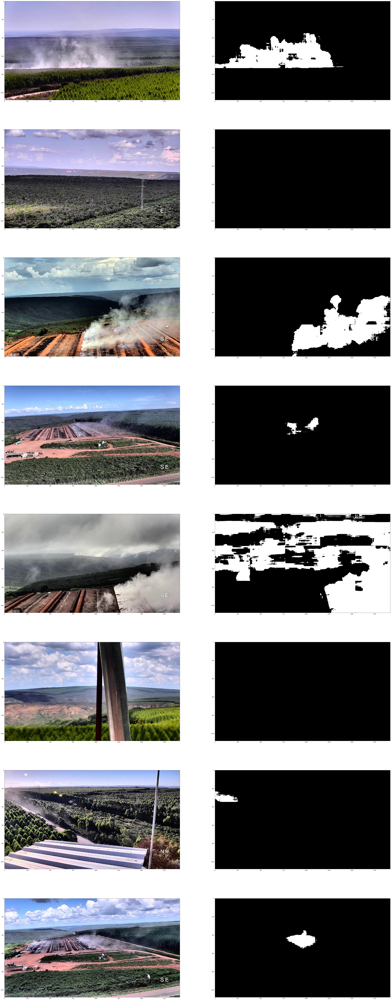

In [100]:
fig=plt.figure(figsize=(60, 160))
dset = original_sel_images[1103:1120]
length = int(len(dset)/2)
columns = 2

count = 0 
for i in range(1, length * columns + 1, 2):
    fig.add_subplot(length, columns, i)
    img = Image.open(os.path.join(test_dir,dset[i]))
    plt.imshow(img)
    fig.add_subplot(length, columns, i+1)
    plt.imshow(output_each_mask(test_dir, dset[i]))
plt.show()